# Notebook for Gene Set Score Analysis

**Created by** : **Srivalli Kolla**

**Devloped on** : September 1,2024 

**Last Modified** : September 11,2024 

**Institute of Systems Immunology, University of Wurzburg**

# Importing packages

In [37]:
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

from SCCAF import SCCAF_assessment, plot_roc

## Set up working environment

In [38]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                 10.3.0
SCCAF               NA
asttokens           NA
attr                23.2.0
cffi                1.16.0
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
defusedxml          0.7.1
distutils           3.12.4
django              5.0.6
executing           2.0.1
h5py                3.11.0
igraph              0.11.5
ipykernel           6.29.5
ipython_genutils    0.2.0
ipywidgets          8.1.3
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
louvain             0.8.2
matplotlib          3.8.4
matplotlib_inline   0.1.7
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numexpr             2.10.1
numpy               1.26.4
packaging           24.1
pandas    

# Data Loading and Preprocessing

In [39]:
cmc = sc.read_h5ad('../data/heart_mm_nuclei-23-0092_CMC_states_ctl240131.raw.h5ad')
cmc

AnnData object with n_obs × n_vars = 8257 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

In [40]:
cmc.obs['cell_states'] = cmc.obs['C_scANVI']

In [41]:
cmc.var

,gene_ids,feature_types,genome,mt,ribo,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
Xkr4,ENSMUSG00000051951,Gene Expression,NA,False,False,2764,0.058250,98.126356,8593.0
Gm1992,ENSMUSG00000089699,Gene Expression,NA,False,False,310,0.002718,99.789859,401.0
Gm19938,ENSMUSG00000102331,Gene Expression,NA,False,False,314,0.002352,99.787148,347.0
Gm37381,ENSMUSG00000102343,Gene Expression,NA,False,False,74,0.000780,99.949837,115.0
Rp1,ENSMUSG00000025900,Gene Expression,NA,False,False,902,0.012791,99.388557,1887.0
...,...,...,...,...,...,...,...,...,...
Ac124606.1,ENSMUSG00000095523,Gene Expression,NA,False,False,0,0.000000,100.000000,0.0
Ac133095.2,ENSMUSG00000095475,Gene Expression,NA,False,False,0,0.000000,100.000000,0.0
Ac133095.1,ENSMUSG00000094855,Gene Expression,NA,False,False,0,0.000000,100.000000,0.0
Ac234645.1,ENSMUSG00000095019,Gene Expression,NA,False,False,0,0.000000,100.000000,0.0


In [42]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

X_is_raw(cmc)

False

Data is already normlaized

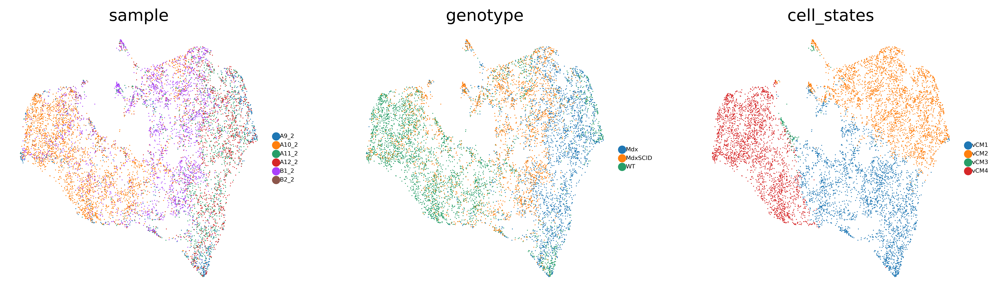

In [43]:
sc.pl.umap(cmc, frameon = False, color = ['sample', 'genotype', 'cell_states'], size = 2.5, legend_fontsize = 5, ncols = 3)

# Gene set scoring

## Interferon gaama signalling

In [44]:
interferon_genes = ['Stat1',
'Ifng',
'Jak1',
'Tyk2',
'Tp53',
'Ifngr1',
'Irf1',
'Jak2',
'Ifngr2',
'Hpx']

In [45]:
sc.tl.score_genes(cmc,
                  gene_list = interferon_genes,
                  score_name = 'interferon_score',
                  random_state = 1712)

computing score 'interferon_score'
    finished: added
    'interferon_score', score of gene set (adata.obs).
    349 total control genes are used. (0:00:00)


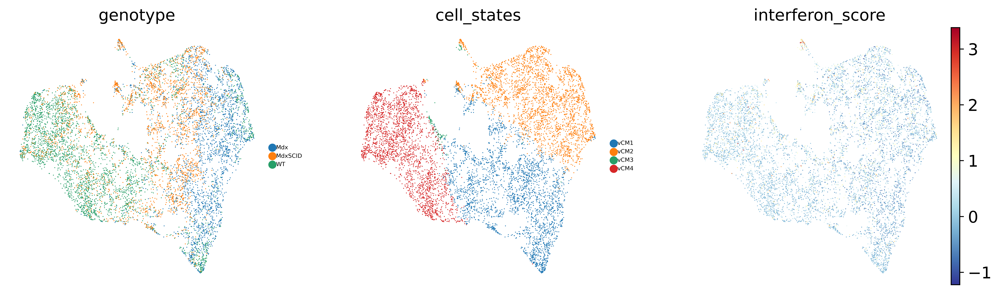

In [46]:
sc.pl.umap(cmc, 
           frameon = False, 
           color = ['genotype', 'cell_states','interferon_score'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdYlBu_r')

In [47]:
present_interferon = cmc.var.index[cmc.var.index.isin(interferon_genes)]
present_interferon = present_interferon.astype(str)
present_interferon

Index(['Stat1', 'Jak1', 'Hpx', 'Tyk2', 'Ifngr1', 'Ifng', 'Irf1', 'Ifngr2',
       'Jak2'],
      dtype='object')

computing PCA
    with n_comps=50


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_utils.py:41: UserWarning: You’re trying to run this on 32285 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


    finished (0:00:07)
Storing dendrogram info using `.uns['dendrogram_cell_states']`


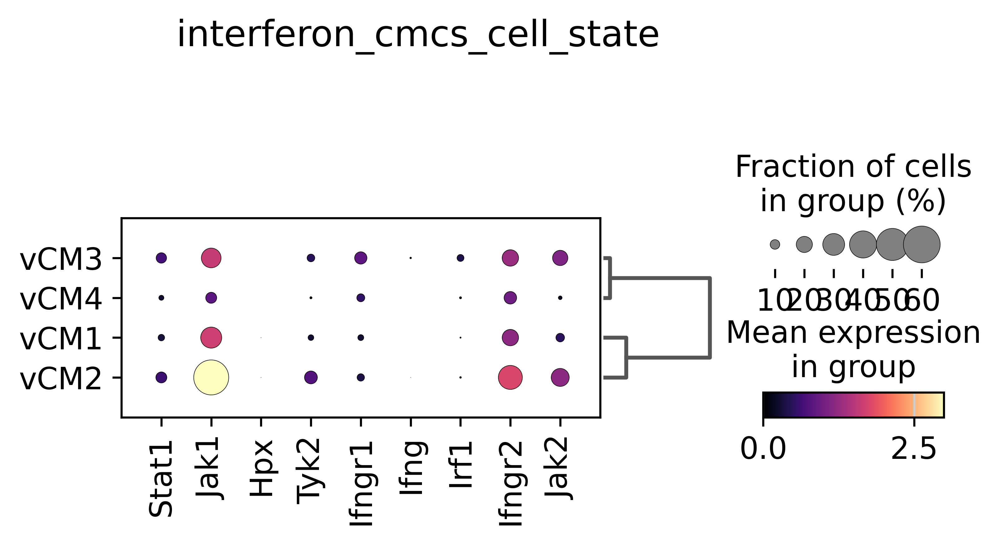

In [48]:
sc.pl.dotplot(cmc, present_interferon,groupby= 'cell_states',
              dendrogram = True,
              cmap = 'magma', title= 'interferon_cmcs_cell_state', save= 'interferon_cmcs_cell_state.png')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_genotype']`


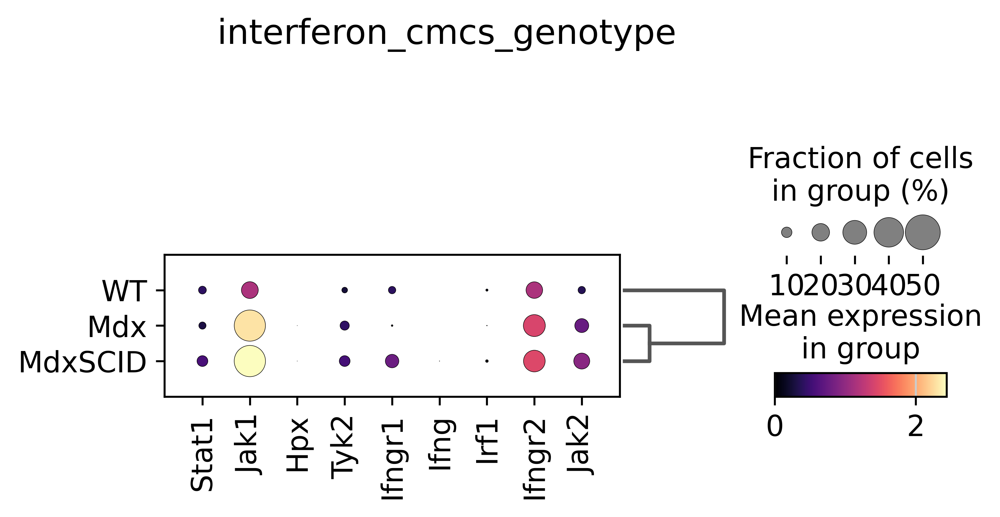

In [49]:
sc.pl.dotplot(cmc, present_interferon,groupby= 'genotype',
              dendrogram = True,
              cmap = 'magma',title= 'interferon_cmcs_genotype',save= 'interferon_cmcs_genotype.png')

## Apoptosis

In [50]:
apoptotic_genes = ['Daxx',
'Col6a3',
'Casp8',
'Gapdh',
'Pfkfb3',
'Tgfb2',
'Pdcl3',
'Snw1',
'Sh3glb1',
'Nradd',
'Clca3a2',
'Diablo',
'Bok',
'Babam2',
'Bcl2l13',
'Egln3',
'Dap3',
'Madd',
'Trp63',
'1600014C10Rik',
'Tfpt',
'Cib1',
'Bcl2l12',
'Trp53',
'Bax',
'Bbc3',
'Ppp1r15a',
'Tmem238l',
'Gm45808',
'Unc5d',
'Bag6',
'Gapdhrt2',
'Elmo3',
'Ppia',
'Birc6',
'Dffb',
'Cflar',
'Stk3',
'Ripk3',
'Bcl2l2',
'Ddit3',
'Bik',
'Tmbim6',
'Tcirg1',
'Sgms1',
'Pmaip1',
'Bad',
'Fas',
'Scml2',
'Zdhhc3',
'Ube4b',
'Casp7',
'Pten',
'Xaf1',
'Rad21',
'Fasl',
'Tnfrsf9',
'Nptx1',
'Bcl2l1',
'Gdf6',
'Rnf186',
'Map3k7',
'Tpx2',
'Casp9',
'Agrn',
'Bmf',
'Birc7',
'Ebf4',
'A5JTV6',
'A6YM30',
'Aifm1',
'Scn2a',
'Tnfrsf25',
'Casp8ap2',
'Trp73',
'Ift57',
'Pde3a',
'Tradd',
'Rrn3',
'Ep300',
'Taok1',
'Rbm25',
'Syce3',
'Ddit4',
'Bcl10',
'Tmf1',
'Cit',
'Gramd4',
'Rps3',
'Slc5a11',
'Tnfaip8',
'Rps27l',
'Bcl2l14',
'Dedd',
'Cidec',
'Pea15a',
'Dnase2a',
'Gm20521',
'Opa1',
'Pdcd10',
'Ciapin1',
'Topaz1',
'Dapk2',
'Rrp8',
'Unc5c',
'Dlc1',
'Fhit',
'Cecr2',
'Ryr2',
'Tgfbr1',
'Coa8',
'Trp53bp2',
'Brat1',
'Bnipl',
'Fgfr3',
'Vdac1',
'Gm29094',
'Syngap1',
'Cdip1',
'Becn1',
'Bak1',
'Prune2',
'Ercc6',
'Il12a',
'Traf7',
'Ppp2r1b',
'Slit2',
'Qrich1',
'Zfp212',
'Apaf1',
'CYCt',
'Senp1',
'Hk2',
'Esr2',
'Angpt1',
'Eya2',
'Stxbp1',
'Endog',
'Mknk1',
'Gzmm',
'Bcl7c',
'Tnfrsf11b',
'Akap1',
'Casp12',
'Casp6',
'Ercc2',
'Birc3',
'Bub1',
'Gcm2',
'Ntn1',
'Gclm',
'Map3k5',
'Atn1',
'Cx3cl1',
'Chek1',
'Xbp1',
'Sema6a',
'Fkbp8',
'C1d',
'Notch2',
'Rabep1',
'Fgf10',
'Bmpr2',
'Axin1',
'C1qbp',
'Tnfrsf18',
'Api5',
'Emp3',
'Dapk3',
'Dffa',
'Csnk2a2',
'Zmat3',
'Tnfsf12',
'Bcl2l11',
'Siva1',
'Bnip2',
'Lgals7',
'Slk',
'Bnip3',
'Snca',
'Dnase1l3',
'Bcl2a1b',
'A1c',
'Bcl2a1d',
'Cd70',
'Birc5',
'Cidea',
'Cideb',
'Gpx4',
'Ppargc1a',
'Sfn',
'Cfdp1',
'Tgfbr3',
'Foxl2',
'Cntfr',
'Dnmt3a',
'Ikbkg',
'Parp2',
'Men1',
'Pglyrp1',
'Pak1',
'Emp2',
'Jtb',
'Cradd',
'Tp63',
'Hipk1',
'Coro1a',
'Abl1',
'Myc',
'Ngf',
'Ins2',
'Ifng',
'Il1a',
'Il3',
'Il2ra',
'Tp53',
'Afp',
'Ada',
'Gzmb',
'Tgfb1',
'Il2',
'Igf1',
'Itgam',
'Jun',
'Krt18',
'Ptprc',
'Enpp1',
'Pim1',
'Tnf',
'Epo',
'Anxa2',
'Il4',
'Hsp90aa1',
'Sod1',
'Il6',
'Nefl',
'Sod2',
'Ptcra',
'Ifi204',
'Rbm10',
'Il7',
'Bcl2',
'Il1b',
'Parp1',
'Gpx1',
'Fgf4',
'Cdk1',
'Dmd',
'Lcn2',
'Krt8',
'Camk2a',
'Agt',
'Gas2',
'Itpr1',
'App',
'Rapsn',
'Nr4a1',
'Pdcd6',
'Gsn',
'Msx1',
'Cd5',
'Rb1',
'Srgn',
'Mecom',
'Anxa6',
'Hmox1',
'Irf1',
'Spn',
'Usp53',
'Lgals1',
'Atf2',
'Hmga1',
'Tgfb3',
'Pou4f1',
'Spi1',
'Gba1',
'Gata1',
'Ccn1',
'Rarg',
'Lsp1',
'Id1',
'Ntf3',
'Prkca',
'Fcer1g',
'Kitlg',
'Bdnf',
'Bmp4',
'Fgfr2',
'Gadd45b',
'Hnf1a',
'Myd88',
'Wt1',
'Rarb',
'Cd3e',
'Wnt4',
'Wnt5a',
'Bmp7',
'Pde6b',
'Pnp',
'Pcgf2',
'Mdm2',
'Cryab',
'Zfp36l1',
'Wnt7a',
'Aldh1a1',
'Cryaa',
'Cd24',
'Tnfrsf1a',
'Tnfrsf1b',
'Nfkb1',
'Bmi1',
'Ctnna1',
'Pik3r1',
'Marcks',
'S100a8',
'Pdia3',
'Lef1',
'Hnf1b',
'Braf',
'Cebpb',
'Wnt7b',
'Col2a1',
'Max',
'Camk2b']

In [51]:
sc.tl.score_genes(cmc,
                  gene_list = apoptotic_genes,
                  score_name = 'apoptotic_score',
                  random_state = 1712)

computing score 'apoptotic_score'
       'Coa8', 'Gm29094', 'CYCt', 'A1c', 'Tp63', 'Tp53', 'Gba1', 'Kitlg',
       'Cd24'],
      dtype='object')
    finished: added
    'apoptotic_score', score of gene set (adata.obs).
    937 total control genes are used. (0:00:00)


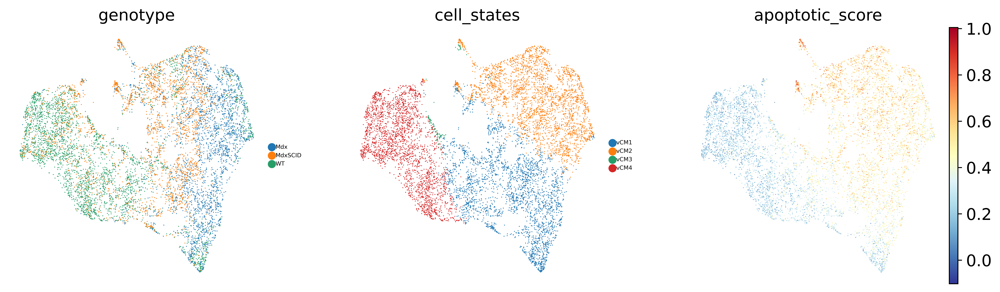

In [52]:
sc.pl.umap(cmc, 
           frameon = False, 
           color = ['genotype', 'cell_states', 'apoptotic_score'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdYlBu_r')

In [53]:
present_apoptotic = cmc.var.index[cmc.var.index.isin(apoptotic_genes)]
present_apoptotic = present_apoptotic.astype(str)
present_apoptotic

Index(['Pdcl3', 'Cflar', 'Casp8', 'Bmpr2', 'Col6a3', 'Bok', 'Bcl2', 'Ptprc',
       'Fasl', 'Fcer1g',
       ...
       'Pten', 'Fas', 'Slk', 'Casp7', 'Gata1', 'Rbm10', 'Aifm1', 'Ikbkg',
       'Dmd', 'Scml2'],
      dtype='object', length=309)

In [54]:
expression_matrix = (cmc[:, present_apoptotic].X > 0).toarray()
expression_df = pd.DataFrame(expression_matrix, index=cmc.obs.index, columns=present_apoptotic)
expression_df['cell_states'] = cmc.obs['cell_states'].values

fraction_expressed = expression_df.groupby('cell_states').mean()


genes_above_threshold = (fraction_expressed.max(axis=0) > 0.4)
filtered_apoptotic = present_apoptotic[genes_above_threshold.values]


/tmp/ipykernel_342029/3323653768.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  fraction_expressed = expression_df.groupby('cell_states').mean()


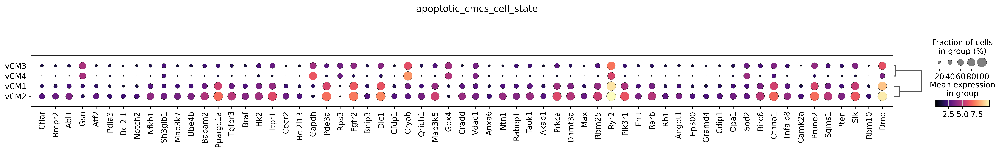

In [55]:
sc.pl.dotplot(cmc, filtered_apoptotic ,groupby= 'cell_states',
              dendrogram = True, 
              cmap = 'magma', title = 'apoptotic_cmcs_cell_state',save= 'apoptotic_cmcs_cell_state.png')

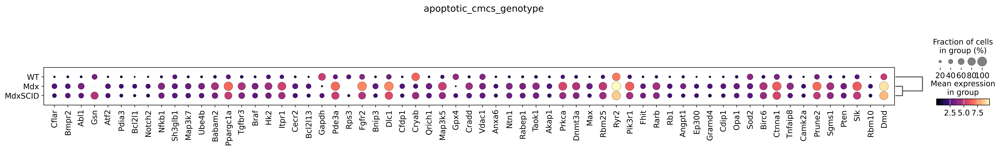

In [56]:
sc.pl.dotplot(cmc, filtered_apoptotic ,groupby= 'genotype', 
              dendrogram = True,
              cmap = 'magma',  title= 'apoptotic_cmcs_genotype',save= 'apoptotic_cmcs_genotype.png')

## Ferroptosis

In [76]:
ferroptosis_genes = ["Ninj1",
    "Tp53",
    "Hmox1"
    "Gpx4",
    "Slc7a11",
    "Acsl4",
    "Tfrc",
    "Fth1",
    "Ftl",
    "Ncoa4",
    "Lpcat3",
    "Alox15",
    "Ptgs2",
    "Nfe2l2",
    "Cisd1",
    "Sat1",
    "Rsl",
    "Gls2",
    "Dpp4"]

In [77]:
sc.tl.score_genes(cmc,
                  gene_list = ferroptosis_genes,
                  score_name = 'ferroptosis_score',
                  random_state = 1712)

computing score 'ferroptosis_score'
    finished: added
    'ferroptosis_score', score of gene set (adata.obs).
    450 total control genes are used. (0:00:00)


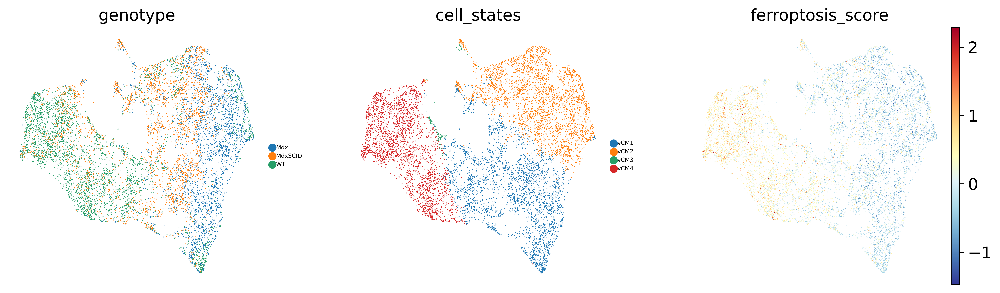

In [78]:
sc.pl.umap(cmc, 
           frameon = False, 
           color = ['genotype', 'cell_states','ferroptosis_score'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdYlBu_r')

In [79]:
present_ferroptosis = cmc.var.index[cmc.var.index.isin(ferroptosis_genes)]
present_ferroptosis = present_ferroptosis.astype(str)
present_ferroptosis

Index(['Ptgs2', 'Dpp4', 'Nfe2l2', 'Slc7a11', 'Lpcat3', 'Cisd1', 'Gls2',
       'Alox15', 'Ninj1', 'Ncoa4', 'Tfrc', 'Fth1', 'Acsl4', 'Sat1'],
      dtype='object')

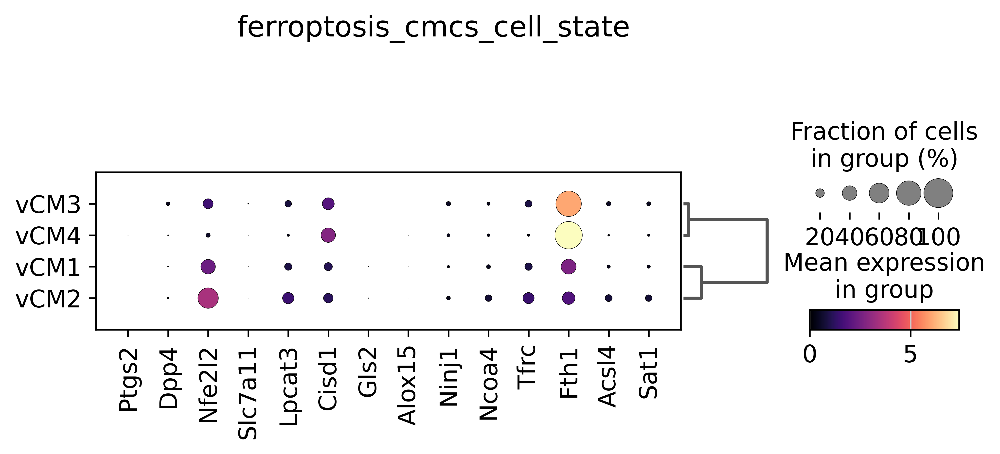

In [80]:
sc.pl.dotplot(cmc,present_ferroptosis,groupby= 'cell_states',
              dendrogram = True,
              cmap = 'magma',title = 'ferroptosis_cmcs_cell_state', save= 'ferroptosis_cmcs_cell_state.png')

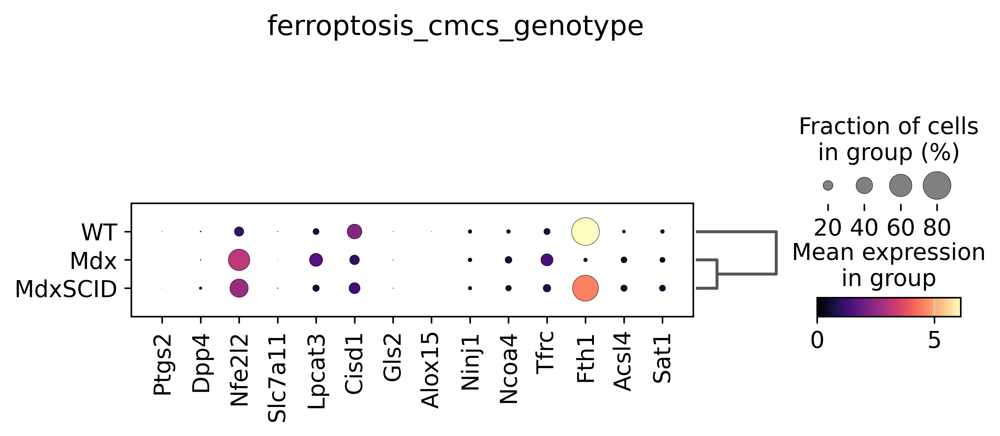

In [81]:
sc.pl.dotplot(cmc, present_ferroptosis,groupby= 'genotype',
              dendrogram = True,
              cmap = 'magma', title= 'ferroptosis_cmcs_genotype',save= 'ferroptosis_cmcs_genotype.png')

## Oxidative Phosphorylation

In [63]:
phosphorylation_genes = ['ND5',
'CYTB',
'ND4',
'ND2',
'COX2',
'ND4L',
'COX1',
'COX3',
'COXI',
'Ndufa7',
'Ndufs1',
'COI',
'Cox5b',
'COXII',
'COXIII',
'Ndufa12',
'Ndufc2',
'Cox7a1',
'Ndufa8',
'Ndufs6',
'Cox8a',
'Sdhaf2',
'Ndufb6',
'Cox4i1',
'Cox8c',
'Proca1',
'Cox7c',
'Co3',
'C0JZQ9',
'C0JZR0',
'Cox7a2l',
'Atp5e',
'Tafazzin',
'Uqcrq',
'Dld',
'Ndufb11',
'Ndufa1',
'Fxn',
'Snca',
'Mt-Cyb',
'Mtco1',
'mt-Co3',
'Mtatp6',
'Mtnd1',
'mt-Nd2',
'mt-Nd3',
'Mtnd4l',
'Mtnd4',
'Mtnd5',
'Mtnd6',
'Ndufb1',
'Cox5a',
'Cox6a2',
'Cox6a1',
'Msh2',
'Cox7a2',
'Cox8b',
'Atp5mf',
'Atp5f1e',
'Cox6b1',
'Cox7b',
'Atp5f1b',
'Bid',
'Atp5pf',
'Coq7',
'Uqcrh',
'Atp5f1a',
'Atp5me',
'mt-Co1',
'Q3TRR5',
'Atp5f1c',
'Uqcr11',
'mt-Nd4',
'Q3UQ68',
'Q3UR21',
'Q3UVI0',
'Uqcc3',
'Afg1l',
'Atp5f1d',
'mt-Nd1',
'Q5BP84',
'Q5BP85',
'Slc25a51',
'Atp5pb',
'Ndufs8',
'Uqcr10',
'Tefm',
'mt-Nd6',
'Q6TM11',
'Q6TM12',
'Q71EJ0',
'Dnajc15',
'Mtch2',
'ATP6',
'Nipsnap2',
'Chchd10',
'Cox6b2',
'Coa6',
'Ndufv3',
'Coq9',
'Sdha',
'Cox4i2',
'Ndufs2',
'Ndufv1',
'Stoml2',
'Ndufa10',
'Ndufs5',
'Ndufa5',
'Cox6c',
'Ndufb2',
'Ndufa2',
'Ndufa3',
'Sdhb',
'Uqcrb',
'Ndufb4',
'Ndufb5',
'Ndufb9',
'Ndufc1',
'Ndufa6',
'Ndufb3',
'Ndufab1',
'Ndufb7',
'Sdhd',
'Ndufs4',
'Uqcrc1',
'Sdhc',
'Cyc1',
'Cox7b2',
'Ndufb8',
'Ndufv2',
'Cox5b-ps',
'Ndufa11',
'Q9D9H8',
'Atp5po',
'Uqcrc2',
'Ndufa9',
'Ndufs7',
'Ndufb10',
'Ndufs3',
'Atp5pd',
'Ndufa13',
'mt-Nd4l',
'mt-Nd5']

In [64]:
sc.tl.score_genes(cmc,
                  gene_list = phosphorylation_genes,
                  score_name = 'phosphorylation_score',
                  random_state = 1712)

computing score 'phosphorylation_score'
       'COI', 'COXII', 'COXIII', 'Co3', 'C0JZQ9', 'C0JZR0', 'Tafazzin',
       'Mt-Cyb', 'Mtco1', 'mt-Co3', 'Mtatp6', 'Mtnd1', 'mt-Nd2', 'mt-Nd3',
       'Mtnd4l', 'Mtnd4', 'Mtnd5', 'Mtnd6', 'Ndufb1', 'Atp5mf', 'Atp5f1e',
       'Atp5f1b', 'Atp5pf', 'Atp5f1a', 'Atp5me', 'mt-Co1', 'Q3TRR5', 'Atp5f1c',
       'mt-Nd4', 'Q3UQ68', 'Q3UR21', 'Q3UVI0', 'Atp5f1d', 'mt-Nd1', 'Q5BP84',
       'Q5BP85', 'Atp5pb', 'mt-Nd6', 'Q6TM11', 'Q6TM12', 'Q71EJ0', 'ATP6',
       'Cox5b-ps', 'Q9D9H8', 'Atp5po', 'Atp5pd', 'mt-Nd4l', 'mt-Nd5'],
      dtype='object')
    finished: added
    'phosphorylation_score', score of gene set (adata.obs).
    546 total control genes are used. (0:00:00)


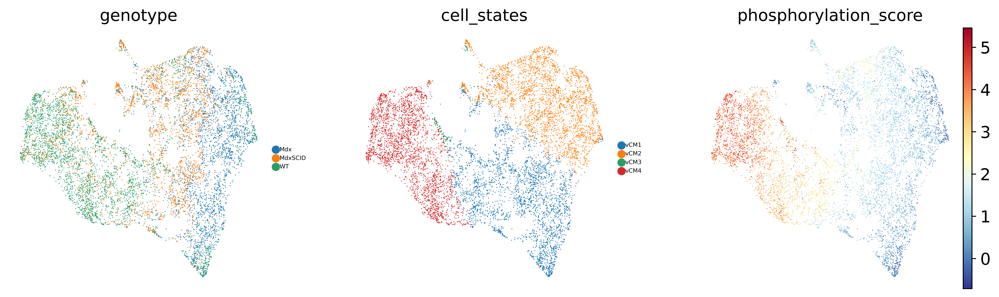

In [65]:
sc.pl.umap(cmc, 
           frameon = False, 
           color = [ 'genotype', 'cell_states','phosphorylation_score'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdYlBu_r')

In [66]:
present_phosphorylation = cmc.var.index[cmc.var.index.isin(phosphorylation_genes)]
present_phosphorylation = present_phosphorylation.astype(str)
present_phosphorylation

Index(['Cox5b', 'Ndufb3', 'Ndufs1', 'Ndufa10', 'Sdhc', 'Ndufs2', 'Ndufa8',
       'Mtch2', 'Ndufs3', 'Cox4i2', 'Atp5e', 'Ndufb5', 'Ndufc1', 'Ndufb6',
       'Stoml2', 'Slc25a51', 'Uqcrh', 'Ndufs5', 'Sdhb', 'Cox7b2', 'Cox6a1',
       'Nipsnap2', 'Ndufa5', 'Ndufb2', 'Snca', 'Bid', 'Ndufa9', 'Ndufa3',
       'Cox6b2', 'Cox7a1', 'Cox6b1', 'Ndufc2', 'Coq7', 'Uqcrc2', 'Ndufab1',
       'Cox6a2', 'Cox8b', 'Ndufa13', 'Ndufb7', 'Coq9', 'Cox4i1', 'Coa6',
       'Sdhd', 'Cox5a', 'Cox7a2', 'Uqcrc1', 'Afg1l', 'Chchd10', 'Ndufs7',
       'Uqcr11', 'Ndufa12', 'Uqcr10', 'Uqcrq', 'Proca1', 'Tefm', 'Dld',
       'Cox8c', 'Uqcrb', 'Ndufs6', 'Sdha', 'Cox7c', 'Ndufs4', 'Dnajc15',
       'Cox6c', 'Ndufb9', 'Cyc1', 'Ndufa6', 'Ndufb4', 'Ndufb10', 'Ndufv3',
       'Ndufa7', 'Ndufa11', 'Ndufv2', 'Cox7a2l', 'Msh2', 'Ndufa2', 'Ndufs8',
       'Ndufv1', 'Cox8a', 'Uqcc3', 'Sdhaf2', 'Fxn', 'Ndufb8', 'Ndufb11',
       'Ndufa1', 'Cox7b'],
      dtype='object')

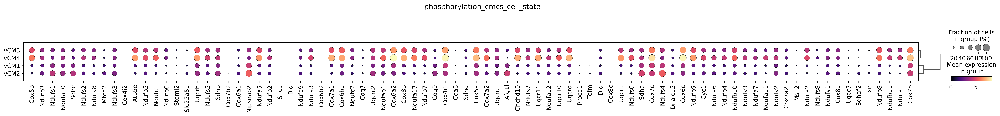

In [67]:
sc.pl.dotplot(cmc, present_phosphorylation,groupby= 'cell_states',
              dendrogram = True,
              cmap = 'magma',title = 'phosphorylation_cmcs_cell_state', save= 'phosphorylation_cmcs_cell_state.png')

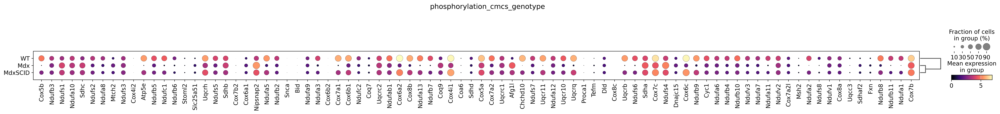

In [68]:
sc.pl.dotplot(cmc, present_phosphorylation,groupby= 'genotype',
              dendrogram = True,
              cmap = 'magma', title='phosphorylation_cmcs_genotype',save= 'phosphorylation_cmcs_genotype.png')

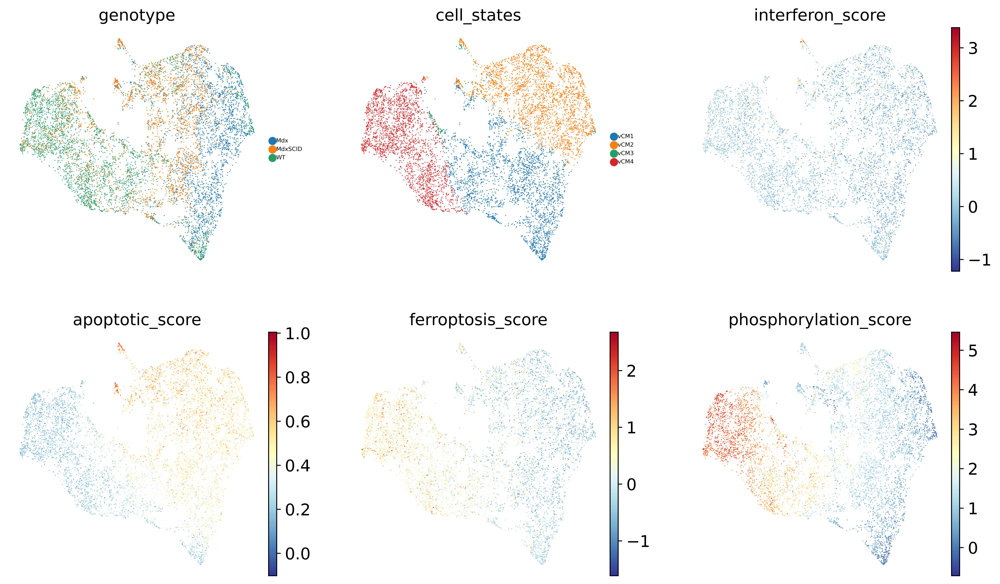

In [69]:
sc.pl.umap(cmc, 
           frameon = False, 
           color = ['genotype', 'cell_states','interferon_score','apoptotic_score','ferroptosis_score','phosphorylation_score'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdYlBu_r')